In [11]:
import os

def loop_through_har_files(root_dir):
    data = {}
    # Loop through the time folders (15 and 60)
    for time_folder in os.listdir(root_dir):
        time_folder_path = os.path.join(root_dir, time_folder)
        
        # Loop through the location folders (satellite and campus)
        for location_folder in os.listdir(time_folder_path):
            location_folder_path = os.path.join(time_folder_path, location_folder)
            
            # Loop through the rate folders (3Mbps and 5Mbps)
            for rate_folder in os.listdir(location_folder_path):
                rate_folder_path = os.path.join(location_folder_path, rate_folder)
                
                # Loop through the experiment folders (1, 2, 3, 4, 5)
                for experiment_folder in os.listdir(rate_folder_path):
                    experiment_folder_path = os.path.join(rate_folder_path, experiment_folder)
                    
                    # Check if the experiment folder contains a QoE folder
                    qoe_folder_path = os.path.join(experiment_folder_path, 'HAR')
                    if os.path.isdir(qoe_folder_path):
                        
                        # Loop through the CSV files in the QoE folder
                        file_data = []
                        for file in os.listdir(qoe_folder_path):
                            file_path = os.path.join(qoe_folder_path, file)
                            
                            # Check if the file is a CSV file
                            if file.endswith('.har'):
                                file_data.append(file_path)
                        
                        data[rate_folder_path] = file_data
        
    return data

# Usage example
root_dir = 'dataset'
data_links = loop_through_har_files(root_dir)


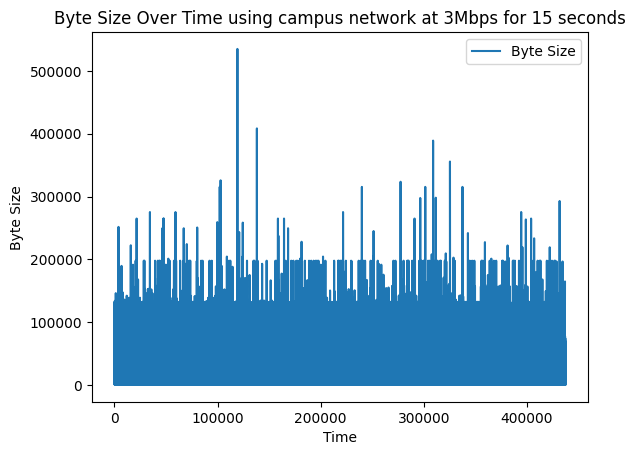

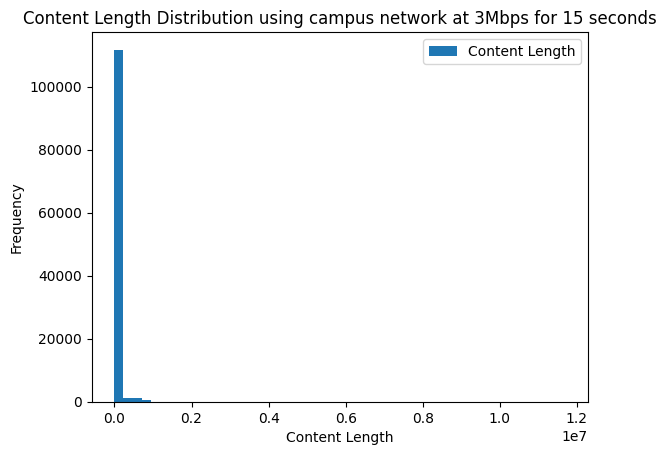

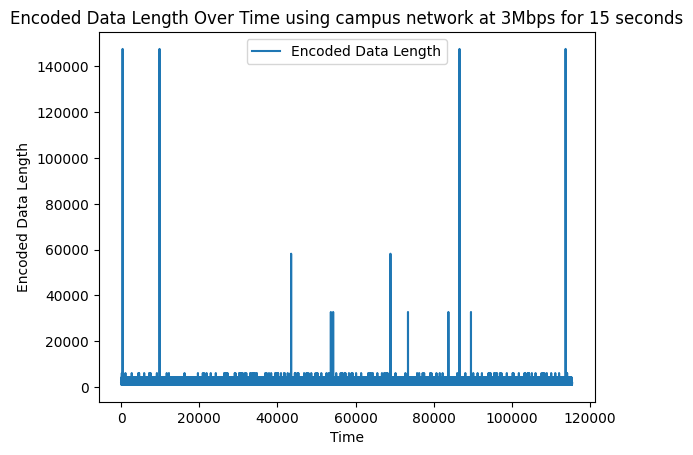

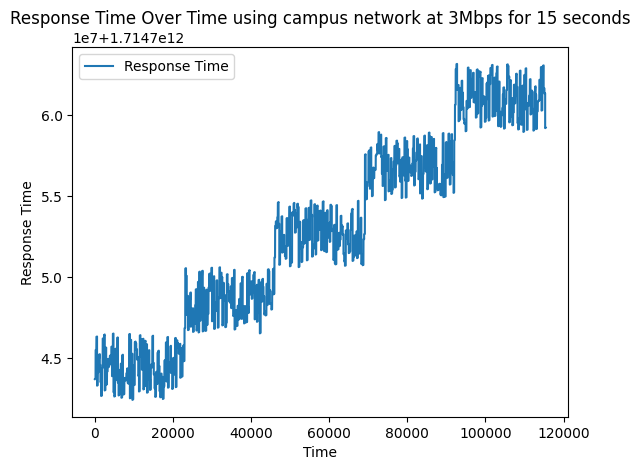

In [9]:
import os
import json
import matplotlib.pyplot as plt

def extract_qos_info(data):
    qos_info = {
        "byte_size": [],
        "content_length": [],
        "encoded_data_length": [],
        "response_time": []
    }

    for entry in data:
        method = entry.get("method")
        params = entry.get("params")

        if method == "Network.dataReceived":
            # Extracting data length for byte size
            data_length = params.get("dataLength")
            if data_length:
                qos_info["byte_size"].append(data_length)
        
        elif method == "Network.responseReceived":
            # Extracting packet information
            response = params.get("response")
            headers = response.get("headers")
            content_length = headers.get("Content-Length")
            if content_length:
                qos_info["content_length"].append(int(content_length))
                qos_info["encoded_data_length"].append(response.get("encodedDataLength"))
                qos_info["response_time"].append(response.get("responseTime"))

    return qos_info

def process_folder(folder_path):
    all_qos_info = {
        "byte_size": [],
        "content_length": [],
        "encoded_data_length": [],
        "response_time": []
    }

    for i in range(1, 6):
        qos_folder_path = os.path.join(folder_path, str(i), "QoS")
        for filename in os.listdir(qos_folder_path):
            if filename.endswith(".json"):
                file_path = os.path.join(qos_folder_path, filename)
                with open(file_path, 'r') as file:
                    data = json.load(file)
                    qos_info = extract_qos_info(data)
                    all_qos_info["byte_size"].extend(qos_info["byte_size"])
                    all_qos_info["content_length"].extend(qos_info["content_length"])
                    all_qos_info["encoded_data_length"].extend(qos_info["encoded_data_length"])
                    all_qos_info["response_time"].extend(qos_info["response_time"])

    return all_qos_info

def create_graphs(qos_info, key):
    # Byte Size Over Time
    dataset, time, location, rate = key.split('/')
    plt.figure()
    plt.plot(qos_info["byte_size"], label="Byte Size")
    plt.xlabel("Time")
    plt.ylabel("Byte Size")
    plt.title(f"Byte Size Over Time using {location} network at {rate} for {time} seconds")
    plt.legend()
    plt.show()

    # Content Length Distribution
    plt.figure()
    plt.hist(qos_info["content_length"], bins=50, label="Content Length")
    plt.xlabel("Content Length")
    plt.ylabel("Frequency")
    plt.title(f"Content Length Distribution using {location} network at {rate} for {time} seconds")
    plt.legend()
    plt.show()

    # Encoded Data Length Over Time
    plt.figure()
    plt.plot(qos_info["encoded_data_length"], label="Encoded Data Length")
    plt.xlabel("Time")
    plt.ylabel("Encoded Data Length")
    plt.title(f"Encoded Data Length Over Time using {location} network at {rate} for {time} seconds")
    plt.legend()
    plt.show()

    # Response Time Over Time
    plt.figure()
    plt.plot(qos_info["response_time"], label="Response Time")
    plt.xlabel("Time")
    plt.ylabel("Response Time")
    plt.title(f"Response Time Over Time using {location} network at {rate} for {time} seconds")
    plt.legend()
    plt.show()

# Usage example
folder_path = "dataset/15/campus/3Mbps"  # Update this path to your folder containing JSON files
all_qos_info = process_folder(folder_path)
create_graphs(all_qos_info, folder_path)



{'version': '1.2', 'creator': {'name': 'BrowserMob Proxy', 'version': '2.1.4', 'comment': ''}, 'pages': [{'id': 'tiktok', 'startedDateTime': '2024-05-03T06:20:14.093-07:00', 'title': 'tiktok', 'pageTimings': {'comment': ''}, 'comment': ''}], 'entries': [{'pageref': 'tiktok', 'startedDateTime': '2024-05-03T06:20:14.966-07:00', 'request': {'method': 'GET', 'url': 'https://www.tiktok.com/@justmaiko/video/6841591262680730886', 'httpVersion': 'HTTP/1.1', 'cookies': [], 'headers': [{'name': 'Host', 'value': 'www.tiktok.com'}, {'name': 'Connection', 'value': 'keep-alive'}, {'name': 'sec-ch-ua', 'value': '"Not A(Brand";v="99", "Google Chrome";v="121", "Chromium";v="121"'}, {'name': 'sec-ch-ua-mobile', 'value': '?0'}, {'name': 'sec-ch-ua-platform', 'value': '"Linux"'}, {'name': 'Upgrade-Insecure-Requests', 'value': '1'}, {'name': 'User-Agent', 'value': 'Mozilla/5.0 (X11; Linux x86_64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/121.0.0.0 Safari/537.36'}, {'name': 'Accept', 'value': 'text/html
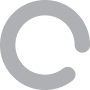
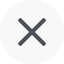
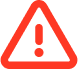
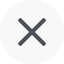
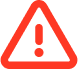
...
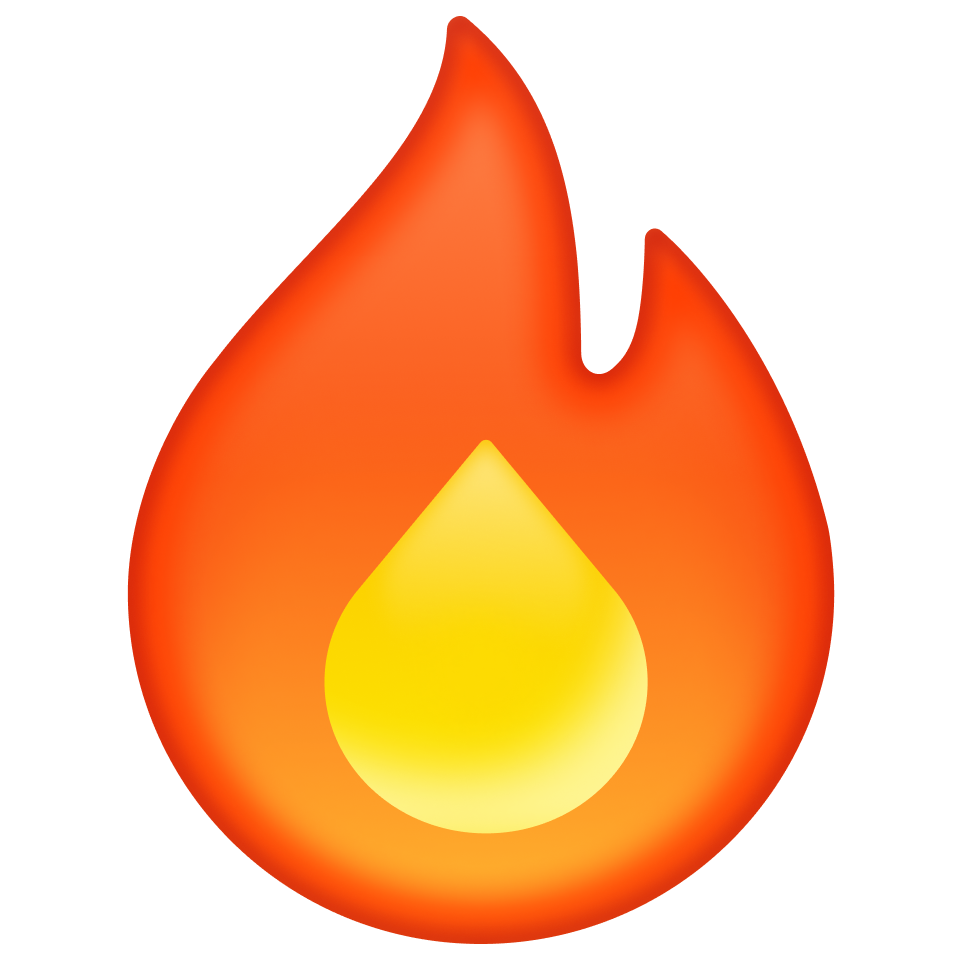
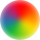
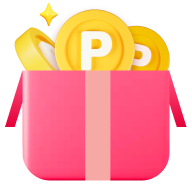
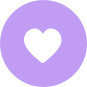
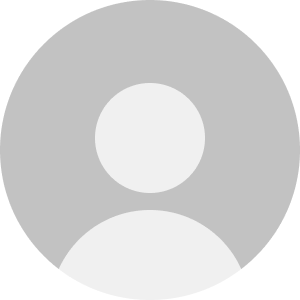

In [6]:
import json

# Load the .har file to inspect its structure
file_path = "dataset/15/campus/3Mbps/1/HAR/run_1_vid_1_6841591262680730886.har"
with open(file_path, 'r') as file:
    har_data = json.load(file)

# Print the top-level keys to understand the structure
print(har_data['log'])

# Extracting the entries from the log
entries = har_data.get("log", {}).get("entries", [])

# # Inspecting the first entry to understand its structure
# if entries:
#     first_entry = entries[0]
#     print(json.dumps(first_entry, indent=4))
# else:
#     print("No entries found in the HAR file.")


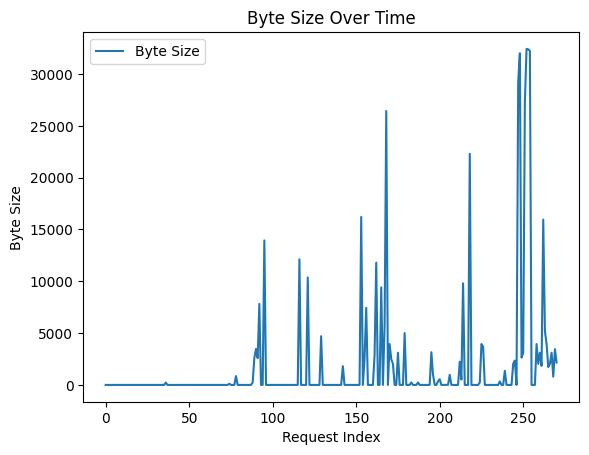

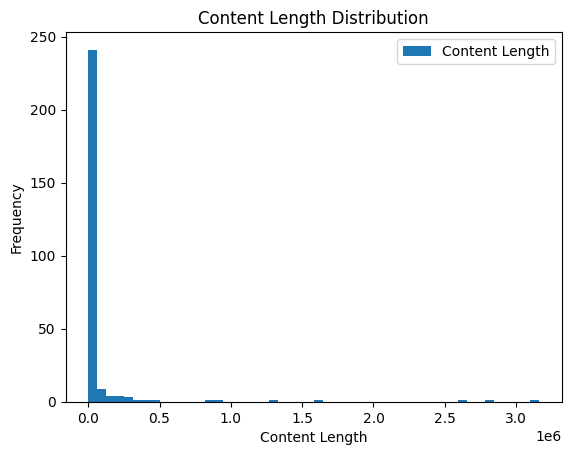

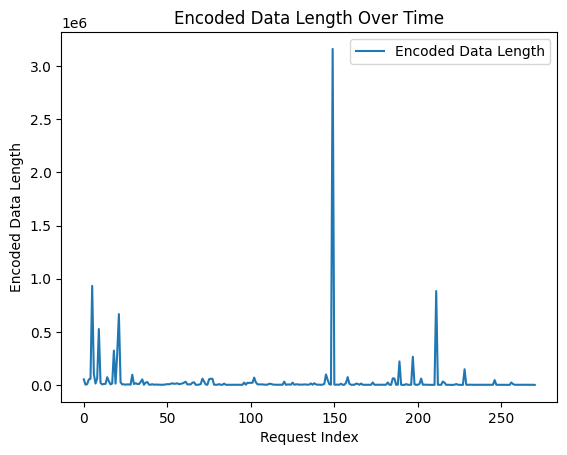

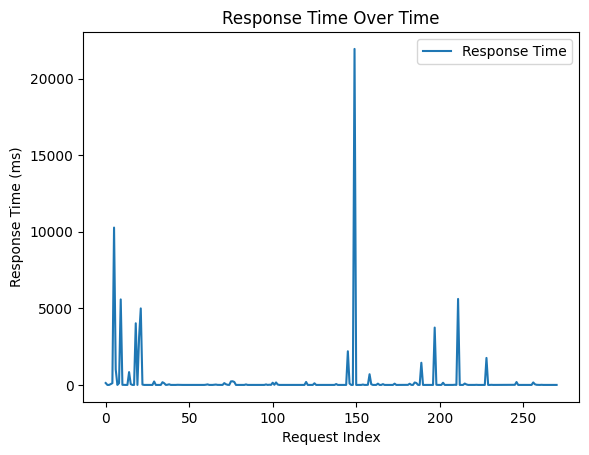

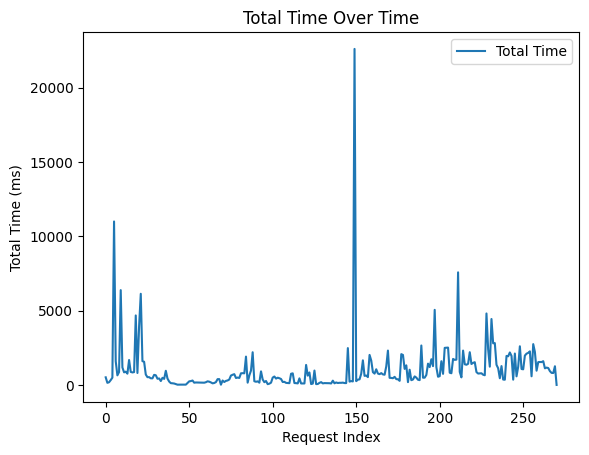

In [7]:
import json
import os
import matplotlib.pyplot as plt

def extract_qos_info(har_data):
    qos_info = {
        "byte_size": [],
        "content_length": [],
        "encoded_data_length": [],
        "response_time": [],
        "timings": [],
        "url": [],
        "status": [],
    }

    entries = har_data.get("log", {}).get("entries", [])
    for entry in entries:
        request = entry.get("request", {})
        response = entry.get("response", {})
        timings = entry.get("timings", {})

        # Extracting byte size
        byte_size = request.get("bodySize", 0)
        qos_info["byte_size"].append(byte_size)

        # Extracting content length
        content_length = response.get("content", {}).get("size", 0)
        qos_info["content_length"].append(content_length)

        # Extracting encoded data length (if available)
        encoded_data_length = response.get("headersSize", 0) + response.get("bodySize", 0)
        qos_info["encoded_data_length"].append(encoded_data_length)

        # Extracting response time
        response_time = timings.get("receive", 0)
        qos_info["response_time"].append(response_time)

        # Extracting total time
        total_time = entry.get("time", 0)
        qos_info["timings"].append(total_time)

        # Extracting URL
        url = request.get("url", "")
        qos_info["url"].append(url)

        # Extracting status
        status = response.get("status", 0)
        qos_info["status"].append(status)

    return qos_info

def process_har_file(file_path):
    with open(file_path, 'r') as file:
        har_data = json.load(file)
    return extract_qos_info(har_data)

def create_graphs(qos_info):
    # Byte Size Over Time
    plt.figure()
    plt.plot(qos_info["byte_size"], label="Byte Size")
    plt.xlabel("Request Index")
    plt.ylabel("Byte Size")
    plt.title("Byte Size Over Time")
    plt.legend()
    plt.show()

    # Content Length Distribution
    plt.figure()
    plt.hist(qos_info["content_length"], bins=50, label="Content Length")
    plt.xlabel("Content Length")
    plt.ylabel("Frequency")
    plt.title("Content Length Distribution")
    plt.legend()
    plt.show()

    # Encoded Data Length Over Time
    plt.figure()
    plt.plot(qos_info["encoded_data_length"], label="Encoded Data Length")
    plt.xlabel("Request Index")
    plt.ylabel("Encoded Data Length")
    plt.title("Encoded Data Length Over Time")
    plt.legend()
    plt.show()

    # Response Time Over Time
    plt.figure()
    plt.plot(qos_info["response_time"], label="Response Time")
    plt.xlabel("Request Index")
    plt.ylabel("Response Time (ms)")
    plt.title("Response Time Over Time")
    plt.legend()
    plt.show()

    # Total Time Over Time
    plt.figure()
    plt.plot(qos_info["timings"], label="Total Time")
    plt.xlabel("Request Index")
    plt.ylabel("Total Time (ms)")
    plt.title("Total Time Over Time")
    plt.legend()
    plt.show()

# Usage example
file_path = "dataset/15/campus/3Mbps/1/HAR/run_1_vid_2_7319932559876525342.har"  # Update this path to your HAR file
qos_info = process_har_file(file_path)
create_graphs(qos_info)


In [14]:
import json

# Load the .har file to inspect its structure
file_path = "dataset/15/campus/3Mbps/1/HAR/run_1_vid_2_7319932559876525342.har"
with open(file_path, 'r') as file:
    har_data = json.load(file)

# Extracting the log entries
entries = har_data.get("log", {}).get("entries", [])

# Print the top-level keys to understand the structure
print(har_data.keys())

# Extracting the first few entries to understand their structure
for i, entry in enumerate(entries[:5]):
    print(f"Entry {i+1}:")
    print(json.dumps(entry, indent=4))
    print("\n\n")


dict_keys(['log'])
Entry 1:
{
    "pageref": "tiktok",
    "startedDateTime": "2024-05-03T06:21:11.507-07:00",
    "request": {
        "method": "GET",
        "url": "https://www.tiktok.com/@justmaiko/video/7319932559876525342",
        "httpVersion": "HTTP/1.1",
        "cookies": [],
        "headers": [
            {
                "name": "Host",
                "value": "www.tiktok.com"
            },
            {
                "name": "Connection",
                "value": "keep-alive"
            },
            {
                "name": "sec-ch-ua",
                "value": "\"Not A(Brand\";v=\"99\", \"Google Chrome\";v=\"121\", \"Chromium\";v=\"121\""
            },
            {
                "name": "sec-ch-ua-mobile",
                "value": "?0"
            },
            {
                "name": "sec-ch-ua-platform",
                "value": "\"Linux\""
            },
            {
                "name": "Upgrade-Insecure-Requests",
                "value": "1"


In [29]:
import json
import os

def is_video_entry(entry):
    request = entry.get("request", {})
    response = entry.get("response", {})
    url = request.get("url", "")
    content_type = None
    
    # Check for content-type in headers
    for header in response.get("headers", []):
        if header.get("name").lower() == "content-type":
            content_type = header.get("value")
            break
    
    # Check if the content-type is related to video or if the URL pattern suggests a video file
    if (content_type and "video" in content_type) or (".mp4" in url or ".webm" in url or ".m3u8" in url or ".ts" in url):
        return True
    return False

def filter_video_entries(har_folder):
    video_entries = {}
    for filename in os.listdir(har_folder):
        if filename.endswith(".har"):
            file_path = os.path.join(har_folder, filename)
            insert = []
            with open(file_path, 'r') as file:
                har_data = json.load(file)
                entries = har_data.get("log", {}).get("entries", [])
                for entry in entries:
                    if is_video_entry(entry):
                        # Extract the bodySize
                        response = entry.get("response", {})
                        body_size = response.get("bodySize", 0)
                        content_type = None
                        for header in response.get("headers", []):
                            if header.get("name").lower() == "content-type":
                                content_type = header.get("value")
                                break
                        video_entry = {
                            "url": entry.get("request", {}).get("url", ""),
                            "content_type": content_type,
                            "body_size": body_size
                        }
                        insert.append(video_entry)
                video_entries[filename] = insert
    return video_entries

har_folder = "dataset/60/campus/5Mbps/1/HAR"
video_entries = filter_video_entries(har_folder)
print(f"Found {video_entries} video-related entries.")
for filename, entries in video_entries.items():
    for entry in entries:
        print(f"File: {filename} - Body Size: {entry.get('body_size')}")


Found {'run_1_vid_61_7315390500196945158.har': [{'url': 'https://v16-webapp-prime.us.tiktok.com/video/tos/useast2a/tos-useast2a-pve-0068/oIcyQJEDQjfB95agflXKEFuIPJFkxRAhMKBC5Q/?a=1988&bti=ODszNWYuMDE6&ch=0&cr=3&dr=0&lr=unwatermarked&cd=0%7C0%7C0%7C&cv=1&br=1898&bt=949&cs=0&ds=3&ft=4KJMyMzm8Zmo00YJN-4jVLObQpWrKsd.&mime_type=video_mp4&qs=0&rc=aDk0OzdlOjszPDk7MzczPEBpajVzeHY5cjVxcDMzNzczM0AwNWItMTUuXzUxLy0tXjNfYSNvcTFsMmRrbS9gLS1kMTZzcw%3D%3D&btag=e00088000&expire=1714998665&l=20240506063026BC3A804E4349E1033CCA&ply_type=2&policy=2&signature=1f590a6d0c6066b485f314c6c97040e9&tk=tt_chain_token', 'content_type': 'video/mp4', 'body_size': 4853239}, {'url': 'https://v16m-webapp.tiktokcdn-us.com/9bf4870952bf483f782fb4f663c45bd7/6638cd89/video/tos/useast2a/tos-useast2a-v-0068/8cc7bc2aa8d2482b8a9380e611874086/?WebIdLastTime=1714977026&a=1988&aid=1988&app_language=en&app_name=tiktok_web&br=23344&browser_language=en-US&browser_name=Mozilla&browser_online=true&browser_platform=Linux%20x86_64&browser_